In [1]:
import cv2
import matplotlib.pyplot as plt
import glob
import os
import matplotlib
import requests
import zipfile
import random
import shutil
import math

In [65]:
# Function copy images from source to destination
src = '/home/enzo.viacava/media/Datasets/Matadero/images'
dst = '/home/enzo.viacava/media/Datasets/Matadero/images_yolo'
src_txt = '/home/enzo.viacava/media/Datasets/Matadero/annotations/test_txt'

def copy_images(src:str, dst:str, train_split:float=0.9, val_split:float=0.1):
    if not os.path.exists(src) or not os.path.exists(src_txt):
        raise FileNotFoundError('Source folder not found')
    if os.path.exists(dst):        
        response = input('Destination folder already exists. Do you want to delete it? [y/n]')
        if response == 'y':
            print('Deleting folder...')
            shutil.rmtree(dst)            
        else:
            # print number of images in destination folders train, val, test
            print('Number of images in train:', len(os.listdir(dst + '/train/images')))
            print('Number of images in val:', len(os.listdir(dst + '/val/images')))
            print('Number of images in test:', len(os.listdir(dst + '/test/images')))
            return
    # Check if destination folder exists
    print('Creating folders...')
    if not os.path.exists(dst):
        os.makedirs(dst)

    # List of images in source folder    
    images = os.listdir(src)

    # Create directories in destination folder
    os.makedirs(dst + '/train', exist_ok=True)
    os.makedirs(dst + '/val', exist_ok=True)
    os.makedirs(dst + '/test', exist_ok=True)

    os.makedirs(dst + '/train/images', exist_ok=True)
    os.makedirs(dst + '/val/images', exist_ok=True)
    os.makedirs(dst + '/test/images', exist_ok=True)

    os.makedirs(dst + '/train/labels', exist_ok=True)
    os.makedirs(dst + '/val/labels', exist_ok=True)
    os.makedirs(dst + '/test/labels', exist_ok=True)

    # Randomize images
    images = random.sample(images, len(images))
    # Filter Folders
    images = [image for image in images if os.path.isfile(src + '/' + image)]

    extension = images[0].split('.')[-1]
    # Copy images in destination folder (train, val, test)
    train = len(images) * train_split
    val = len(images) * val_split
    test = len(images) - train - val

    print('Copying images...')

    for i, image in enumerate(images):
        # Check if image is in source folder
        if os.path.exists(src_txt + '/' + image.replace('.' + extension, '.txt')):
            if i < train:
                shutil.copy(src + '/' + image, dst + '/train/images')
                # Copy txt from src_txt to destination
                shutil.copy(src_txt + '/' + image.replace('.' + extension, '.txt'), dst + '/train/labels')

            elif i < train + val:
                shutil.copy(src + '/' + image, dst + '/val/images')
                # Copy txt from src_txt to destination
                shutil.copy(src_txt + '/' + image.replace('.' + extension, '.txt'), dst + '/val/labels')
            else:
                if test <= 0:
                    break
                shutil.copy(src + '/' + image, dst + '/test/images')
                # Copy txt from src_txt to destination
                shutil.copy(src_txt + '/' + image.replace('.' + extension, '.txt'), dst + '/test/labels')
           
                # print number of images in destination folders train, val, test
    print('Number of images in train:', len(os.listdir(dst + '/train/images')))
    print('Number of labels in train:', len(os.listdir(dst + '/train/labels')))
    print('Number of images in val:', len(os.listdir(dst + '/val/images')))
    print('Number of labels in val:', len(os.listdir(dst + '/val/labels')))
    print('Number of images in test:', len(os.listdir(dst + '/test/images')))
    print('Number of labels in test:', len(os.listdir(dst + '/test/labels')))
    print('Done!')


In [66]:
copy_images(src, dst, 0.8, 0.2)

Deleting folder...
Creating folders...
Copying images...
Number of images in train: 45
Number of labels in train: 45
Number of images in val: 12
Number of labels in val: 12
Number of images in test: 0
Number of labels in test: 0
Done!


In [4]:
# Plot and visualize images in a 2x2 grid.
def visualize(result_dir):
    """
    Function accepts a list of images and plots
    them in either a 1x1 grid or 2x2 grid.
    """
    plt.figure(figsize=(15, 12))
    image_names = glob.glob(os.path.join(result_dir, '*.png'))
    if len(image_names) < 4:
        for i, image_name in enumerate(image_names):
            image = plt.imread(image_name)
            plt.subplot(1, 1, i+1)
            plt.imshow(image)
            plt.axis('off')
            break
    if len(image_names) >= 4:
        for i, image_name in enumerate(image_names):
            image = plt.imread(image_name)
            plt.subplot(2, 2, i+1)
            plt.imshow(image)
            plt.axis('off')
            if i == 3:
                break
    plt.tight_layout()
    plt.show()


In [5]:
#!yolo predict model=yolov8n.pt source='/home/enzo.viacava/media/Datasets/Matadero/images_yolo/train/images/2023-12-14_11-25-37-4270.png' save=True conf=0.5

In [6]:
import cv2
import matplotlib.pyplot as plt
import glob
import os
import matplotlib
import requests
import zipfile
import random
import shutil
import math#visualize('runs/detect/predict3')

In [7]:
# # Import the YOLO module from ultralytics.
# from ultralytics import YOLO

# # Initialize the model.
# model = YOLO('yolov8n.pt') # This will load the pretrained model.

# # Inference.
# outputs = model.predict(source='/home/enzo.viacava/media/Datasets/Matadero/images_yolo/train/images/2023-12-14_11-40-51-6140.png', save=True)

In [8]:
# visualize('runs/detect/predict8')

In [42]:
classes = [
    'Pieza',
    'Biliar', 
    'Fecal', 
    'Cerdo',
    'Feca'
]

colors = [
    (239, 245, 2),
    (27, 36, 245),
    (90, 232, 98),
    (255, 0, 0),
    (0, 0, 255)
]

In [10]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [44]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # Denormalize the coordinates.
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)

        thickness = max(2, int(w/275))
        print(labels[box_num])    

        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[int(labels[box_num])][::-1],
            thickness=thickness
        )
        cv2.putText(
            image,
            text=classes[int(labels[box_num])],
            org=(xmin, ymin-5),
            fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=3.5,
            color=colors[int(labels[box_num])][::-1],
            thickness=4,
            lineType=cv2.LINE_AA
            )
    return image

In [33]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_images = []
    all_images.extend(glob.glob(image_paths+'/*.png'))
    all_images.extend(glob.glob(image_paths+'/*.png'))
    
    all_images.sort()

    num_images = len(all_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image_name = all_images[j]
        image_name = '.'.join(image_name.split(os.path.sep)[-1].split('.')[:-1])
        image = cv2.imread(all_images[j])
        with open(os.path.join(label_paths, image_name+'.txt'), 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=1)
    plt.tight_layout()
    plt.show()

In [23]:
# Read coco dataset
import json

with open('/home/enzo.viacava/media/Datasets/Matadero/annotations/2_class_bbox.json', 'r') as f:
    coco = json.load(f)

In [24]:
coco

{'licenses': [{'name': '', 'id': 0, 'url': ''}],
 'info': {'contributor': '',
  'date_created': '',
  'description': '',
  'url': '',
  'version': '',
  'year': ''},
 'categories': [{'id': 1, 'name': 'Pieza', 'supercategory': ''},
  {'id': 2, 'name': 'Biliar', 'supercategory': ''},
  {'id': 3, 'name': 'Fecal', 'supercategory': ''},
  {'id': 4, 'name': 'Cerdo', 'supercategory': ''},
  {'id': 5, 'name': 'Feca', 'supercategory': ''}],
 'images': [{'id': 1,
   'width': 4092,
   'height': 3000,
   'file_name': '2023-12-14_11-25-37-4270.png',
   'license': 0,
   'flickr_url': '',
   'coco_url': '',
   'date_captured': 0},
  {'id': 2,
   'width': 4092,
   'height': 3000,
   'file_name': '2023-12-14_11-25-40-5050.png',
   'license': 0,
   'flickr_url': '',
   'coco_url': '',
   'date_captured': 0},
  {'id': 3,
   'width': 4092,
   'height': 3000,
   'file_name': '2023-12-14_11-26-09-7080.png',
   'license': 0,
   'flickr_url': '',
   'coco_url': '',
   'date_captured': 0},
  {'id': 4,
   'widt

In [22]:
coco['images']

[{'id': 1,
  'width': 4092,
  'height': 3000,
  'file_name': '2023-12-14_11-25-37-4270.png',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 {'id': 2,
  'width': 4092,
  'height': 3000,
  'file_name': '2023-12-14_11-25-40-5050.png',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 {'id': 3,
  'width': 4092,
  'height': 3000,
  'file_name': '2023-12-14_11-26-09-7080.png',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 {'id': 4,
  'width': 4092,
  'height': 3000,
  'file_name': '2023-12-14_11-26-24-6980.png',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 {'id': 5,
  'width': 4092,
  'height': 3000,
  'file_name': '2023-12-14_11-26-28-2860.png',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 {'id': 6,
  'width': 4092,
  'height': 3000,
  'file_name': '2023-12-14_11-26-54-2760.png',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  '

In [67]:
cat_exclude = [0, 1, 3, 4]
#cat_exclude = []
# read all bounding boxes and labels from the coco dataset and create a txt file for each image
def create_labels(coco, label_path):

    for image in coco['images']:
        image_name = image['file_name']
        image_id = image['id']
        # Open only if image has annotations
        if image_id in [annotation['image_id'] for annotation in coco['annotations'] if annotation['category_id'] not in cat_exclude]:

            with open(os.path.join(label_path, image_name.replace('.png', '.txt')), 'w') as f:
                for annotation in coco['annotations']:
                    if annotation['image_id'] == image_id and annotation['category_id'] is not None:
                        category_id = annotation['category_id']                    
                        if category_id not in cat_exclude:
                            # Map category_id from 0 to n
                            if category_id == 2:
                                category_id = 0
                            elif category_id == 5:
                                category_id = 1
                            else:
                                continue

                            print(category_id)
                            bbox = annotation['bbox']
                            x, y, w, h = bbox
                            x_c = x + w/2
                            y_c = y + h/2
                            # Normalize the coordinates
                            x_c /= image['width']
                            y_c /= image['height']
                            w /= image['width']
                            h /= image['height']
                            # Check if image has any bounding box
                            if len(bbox) != 0:                            
                                f.write(f'{category_id} {round(x_c, 6)} {round(y_c, 6)} {round(w, 6)} {round(h, 6)}\n')

In [68]:
create_labels(coco, '/home/enzo.viacava/media/Datasets/Matadero/annotations/test_txt')

0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
1
1
0
0
1
1
1
1
1
0
0
1
1
1
1
1
1
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
0
0
1
1
1


3
3
1
3
3
1
1
3
3
2
4
2
3
4


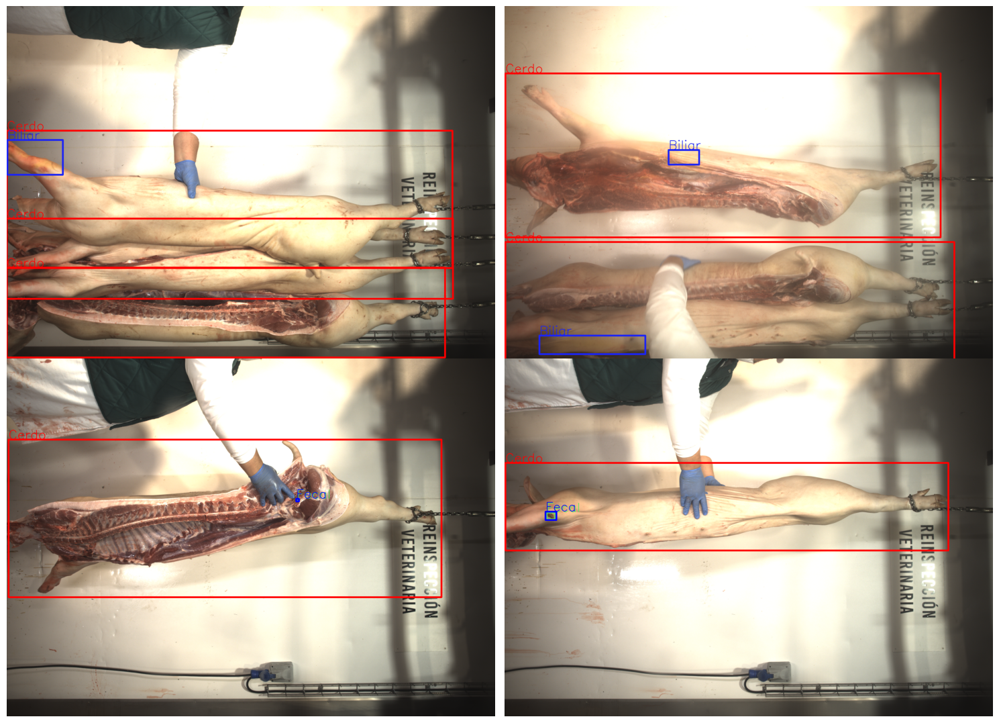

In [45]:
# Visualize a few training images.
plot(
    image_paths=dst + '/train/images', 
    label_paths=dst + '/train/labels',
    num_samples=4,
)

In [69]:
cwd = os.getcwd()
print(cwd)

/home/enzo.viacava


In [70]:
import yaml

attr = {
    'path': cwd+'/home/enzo.viacava/media/Datasets/Matadero/images_yolo',
    'train': '/home/enzo.viacava/media/Datasets/Matadero/images_yolo/train',
    'val': '/home/enzo.viacava/media/Datasets/Matadero/images_yolo/val',
    'test': '/home/enzo.viacava/media/Datasets/Matadero/images_yolo/test',
    
    'names': {
          0: 'Biliar',
          1: 'Fecal',
        #   2: 'Fecal',
        #   3: 'Cerdo',
        #   4: 'Feca',
    }
}

In [71]:
with open('matadero.yaml', 'w') as f:
    yaml.dump(attr, f)

In [56]:
%load_ext tensorboard
%tensorboard --logdir 'runs/detect/' --port 6009

Reusing TensorBoard on port 6009 (pid 25438), started 23:04:37 ago. (Use '!kill 25438' to kill it.)

In [79]:
EPOCHS = 1200
!yolo \
task=detect \
mode=train \
model=yolov8s-p2.yaml \
pretrained=yolov8s.pt \
imgsz=640 \
data=matadero.yaml \
epochs={EPOCHS} \
batch=16 \
name=yolov8s-p2_640_2_class_{EPOCHS} \
exist_ok=True \
device=0,1,2,3
# fliplr=0.6 \
# flipud=0.6 \
# mosaic=0.8

Transferred 219/437 items from pretrained weights
Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CUDA:0 (A100-SXM4-40GB, 40537MiB)
                                                            CUDA:1 (A100-SXM4-40GB, 40537MiB)
                                                            CUDA:2 (A100-SXM4-40GB, 40537MiB)
                                                            CUDA:3 (A100-SXM4-40GB, 40537MiB)
engine/trainer: task=detect, mode=train, model=yolov8s-p2.yaml, data=matadero.yaml, epochs=1200, time=None, patience=100, batch=16, imgsz=1920, save=True, save_period=-1, cache=False, device=(0, 1, 2, 3), workers=8, project=None, name=yolov8s-p2_1920_2_class_1200, exist_ok=True, pretrained=yolov8s.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, s

In [22]:
# Evaluation on the test set.
!yolo val \
split='val' \
model='runs/detect/yolov8s-p2_640_2_class_1200/weights/best.pt' \
data='matadero.yaml' \
plots=True \
device=0

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CUDA:0 (A100-SXM4-40GB, 40537MiB)
YOLOv8s-p2 summary (fused): 207 layers, 10626968 parameters, 0 gradients, 36.6 GFLOPs
val: Scanning /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/labels.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all         12         15      0.793        0.8      0.806      0.371
                Biliar         12          5      0.946          1      0.995      0.443
                 Fecal         12         10       0.64        0.6      0.617      0.299
Speed: 0.3ms preprocess, 9.2ms inference, 0.0ms loss, 115.1ms postprocess per image
Results saved to runs/detect/val7
💡 Learn more at https://docs.ultralytics.com/modes/val


In [82]:
# Plot and visualize images in a 2x2 grid.
def visualize(result_dir):
    """
    Function accepts a list of images and plots
    them in either a 1x1 grid or 2x2 grid.
    """
    image_names = glob.glob(os.path.join(result_dir, '*.png'))
    # random images
    image_names = random.sample(image_names, len(image_names))
    if len(image_names) < 4:
        plt.figure(figsize=(10, 7))
        for i, image_name in enumerate(image_names):
            image = plt.imread(image_name)
            plt.subplot(1, 1, i+1)
            plt.imshow(image)
            plt.axis('off')
            break
    if len(image_names) >= 4:
        plt.figure(figsize=(15, 12))
        for i, image_name in enumerate(image_names):
            image = plt.imread(image_name)
            plt.subplot(2, 2, i+1)
            plt.imshow(image)
            plt.axis('off')
            if i == 3:
                break
    plt.tight_layout()
    plt.show()

In [83]:
!yolo predict \
model='runs/detect/yolov8s-p2_1920_2_class_{EPOCHS}/weights/best.pt' \
source='/home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images' \
name='yolov8s-p2-1920_2_class_predict' \
exist_ok=True \
save=True \
conf=0.08 \
iou=0.2 \
agnostic_nms = True 
#classes = [0,1]

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CUDA:0 (A100-SXM4-40GB, 40537MiB)
YOLOv8s-p2 summary (fused): 207 layers, 10626968 parameters, 0 gradients, 36.6 GFLOPs

image 1/12 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_11-27-12-0290.png: 1408x1920 2 Biliars, 103.3ms
image 2/12 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_11-27-33-0640.png: 1408x1920 1 Biliar, 12.3ms
image 3/12 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-13-34-8600.png: 1408x1920 1 Fecal, 12.3ms
image 4/12 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-28-24-5200.png: 1408x1920 1 Fecal, 12.3ms
image 5/12 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-28-26-9600.png: 1408x1920 1 Fecal, 12.3ms
image 6/12 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-28-51-9610.png: 1408x1920 1 Fecal, 12.3ms
image 7/12 /home/e

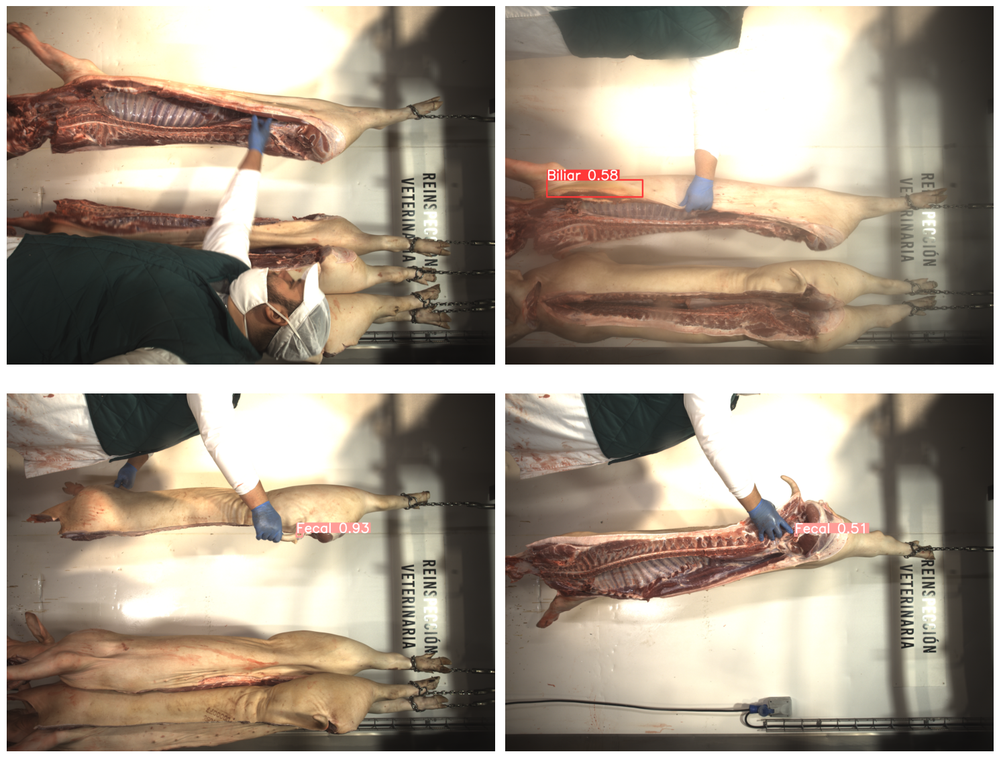

In [84]:
visualize('runs/detect/yolov8s-p2-1920_2_class_predict')

In [91]:
!yolo predict \
model='runs/detect/yolov8s-p2_1920_2_class_{EPOCHS}/weights/best.pt' \
source='/home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-35-33-4210.png' \
name='predict' \
exist_ok=True \
save=True \
conf=0.08 \
iou=0.2 \
agnostic_nms = True \
device='cpu'

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CPU (AMD EPYC 7742 64-Core Processor)
YOLOv8s-p2 summary (fused): 207 layers, 10626968 parameters, 0 gradients, 36.6 GFLOPs

image 1/1 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-35-33-4210.png: 1408x1920 1 Fecal, 655.0ms
Speed: 18.3ms preprocess, 655.0ms inference, 793.2ms postprocess per image at shape (1, 3, 1408, 1920)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CPU (AMD EPYC 7742 64-Core Processor)
YOLOv8s-p2 summary (fused): 207 layers, 10626968 parameters, 0 gradients, 36.6 GFLOPs

image 1/1 /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-35-33-4210.png: 1408x1920 1 Fecal, 591.0ms
Speed: 18.6ms preprocess, 591.0ms inference, 974.9ms postprocess per image at shape (1, 3, 1408, 1920)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


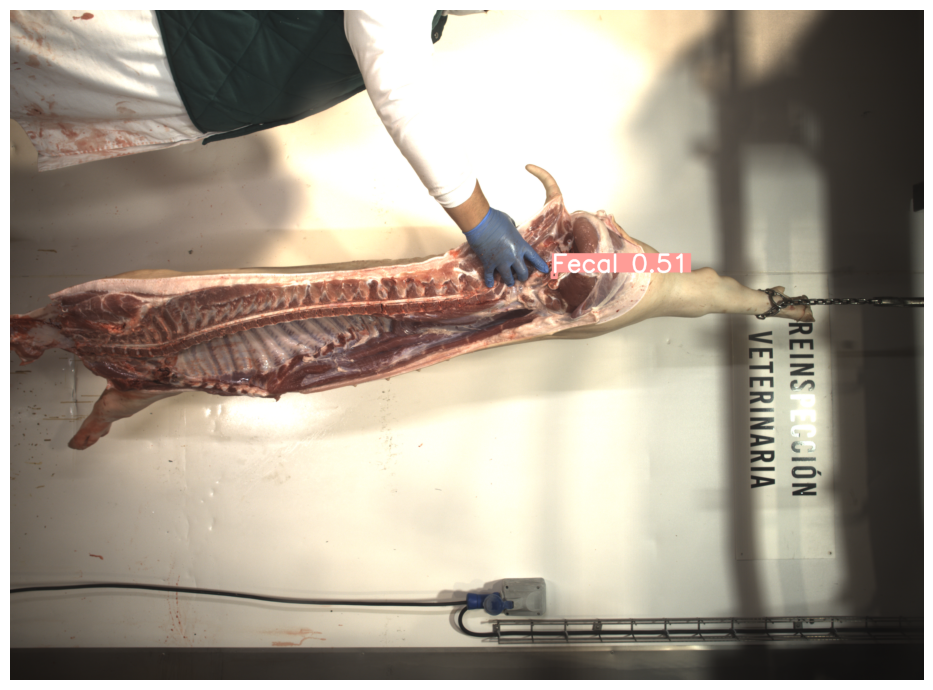

In [97]:
import subprocess

source = '/home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/images/2023-12-14_12-35-33-4210.png'

def run_yolo_predict(epochs, source):
    if os.path.exists('runs/detect/predict'):
        shutil.rmtree('runs/detect/predict')
    command = f"""
    yolo predict \
    model='runs/detect/yolov8s-p2_1920_2_class_{epochs}/weights/best.pt' \
    source={source} \
    name='predict' \
    exist_ok=True \
    save=True \
    conf=0.08 \
    iou=0.2 \
    agnostic_nms=True \
    device='cpu'
    """
    process = subprocess.Popen(command, shell=True)
    process.wait()

    visualize('runs/detect/predict')

    # Delete content of predict folder
    

# Example usage:
run_yolo_predict(1200, source)

In [10]:
from ultralytics.utils.benchmarks import benchmark

# Benchmark on GPU
benchmark(model='runs/detect/yolov8s-p2_1920_2_class_1200/weights/best.pt', data='matadero.yaml', imgsz=640, half=False, device='cpu')

Setup complete ✅ (256 CPUs, 1007.7 GB RAM, 1311.1/1758.7 GB disk)

Benchmarks complete for best.pt on matadero.yaml at imgsz=640 (442.84s)
                   Format Status❔  Size (MB)  metrics/mAP50-95(B)  Inference time (ms/im)
0                 PyTorch       ✅       21.9               0.0543                  126.96
1             TorchScript       ✅       41.3               0.0540                  108.99
2                    ONNX       ✅       41.2               0.0540                  201.81
3                OpenVINO       ✅       41.2               0.0540                   55.94
4                TensorRT       ❌        0.0                  NaN                     NaN
5                  CoreML       ❎       20.6                  NaN                     NaN
6   TensorFlow SavedModel       ❌        0.0                  NaN                     NaN
7     TensorFlow GraphDef       ❌        0.0                  NaN                     NaN
8         TensorFlow Lite       ❌        0.0       

,Format,Status❔,Size (MB),metrics/mAP50-95(B),Inference time (ms/im)
0,PyTorch,✅,21.9,0.0543,126.96
1,TorchScript,✅,41.3,0.0540,108.99
2,ONNX,✅,41.2,0.0540,201.81
3,OpenVINO,✅,41.2,0.0540,55.94
4,TensorRT,❌,0.0,NaN,NaN
5,CoreML,❎,20.6,NaN,NaN
6,TensorFlow SavedModel,❌,0.0,NaN,NaN
7,TensorFlow GraphDef,❌,0.0,NaN,NaN
8,TensorFlow Lite,❌,0.0,NaN,NaN
9,TensorFlow Edge TPU,❌,0.0,NaN,NaN


In [6]:
from ultralytics import YOLO
from ultralytics.utils.benchmarks import benchmark

model = YOLO('runs/detect/yolov8s-p2_1920_2_class_1200/weights/best.pt')  # Load your model
data = 'matadero.yaml'  # Define your dataset

# Benchmark across specific formats
for format in ['torchscript', 'onnx', 'openvino']:
    model.export(format=format)  # Export to the format
#     benchmark(model=f'yolov8s-p2_1920_2_class_1200.{format}', data=data, imgsz=640, device='cpu')  # Run benchmark

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CPU (AMD EPYC 7742 64-Core Processor)
YOLOv8s-p2 summary (fused): 207 layers, 10626968 parameters, 0 gradients, 36.6 GFLOPs

PyTorch: starting from 'runs/detect/yolov8s-p2_1920_2_class_1200/weights/best.pt' with input shape (1, 3, 1920, 1920) BCHW and output shape(s) (1, 6, 306000) (21.9 MB)

TorchScript: starting export with torch 2.2.2+cu121...
TorchScript: export success ✅ 5.4s, saved as 'runs/detect/yolov8s-p2_1920_2_class_1200/weights/best.torchscript' (44.5 MB)

Export complete (8.7s)
Results saved to /home/enzo.viacava/runs/detect/yolov8s-p2_1920_2_class_1200/weights
Predict:         yolo predict task=detect model=runs/detect/yolov8s-p2_1920_2_class_1200/weights/best.torchscript imgsz=1920  
Validate:        yolo val task=detect model=runs/detect/yolov8s-p2_1920_2_class_1200/weights/best.torchscript imgsz=1920 data=matadero.yaml  
Visualize:       https://netron.app
Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu


[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python -m pip install --upgrade pip


OpenVINO: export success ✅ 13.5s, saved as 'runs/detect/yolov8s-p2_1920_2_class_1200/weights/best_openvino_model/' (44.3 MB)

Export complete (16.8s)
Results saved to /home/enzo.viacava/runs/detect/yolov8s-p2_1920_2_class_1200/weights
Predict:         yolo predict task=detect model=runs/detect/yolov8s-p2_1920_2_class_1200/weights/best_openvino_model imgsz=1920  
Validate:        yolo val task=detect model=runs/detect/yolov8s-p2_1920_2_class_1200/weights/best_openvino_model imgsz=1920 data=matadero.yaml  
Visualize:       https://netron.app


In [10]:
from ultralytics import YOLO

# Load a YOLOv8n PyTorch model
model = YOLO('/home/enzo/runs/detect/yolov8s-p2_640_2_class_1200/weights/best.pt')

# Export the model
model.export(format='openvino')  # creates 'yolov8n_openvino_model/'

WARNING ⚠️ /home/enzo/runs/detect/yolov8s-p2_640_2_class_1200/weights/best.pt appears to require 'dill', which is not in ultralytics requirements.
AutoInstall will run now for 'dill' but this feature will be removed in the future.
Recommend fixes are to train a new model using the latest 'ultralytics' package or to run a command with an official YOLOv8 model, i.e. 'yolo predict model=yolov8n.pt'
requirements: Ultralytics requirement ['dill'] not found, attempting AutoUpdate...
requirements: ❌ AutoUpdate skipped (offline)


ModuleNotFoundError: No module named 'dill'

In [11]:
from ultralytics import YOLO

# Load the exported OpenVINO model
ov_model = YOLO('/home/enzo/runs/detect/yolov8s-p2_640_2_class_1200/weights/best_openvino_model/')

# Run inference
results = ov_model('/home/enzo/images_yolo/val/images/2023-12-14_12-44-11-5670.png', conf=0.05, device='cpu')

Loading /home/enzo/runs/detect/yolov8s-p2_640_2_class_1200/weights/best_openvino_model for OpenVINO inference...
Using OpenVINO LATENCY mode for batch=1 inference...

image 1/1 /home/enzo/images_yolo/val/images/2023-12-14_12-44-11-5670.png: 640x640 1 Fecal, 138.8ms
Speed: 4.1ms preprocess, 138.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


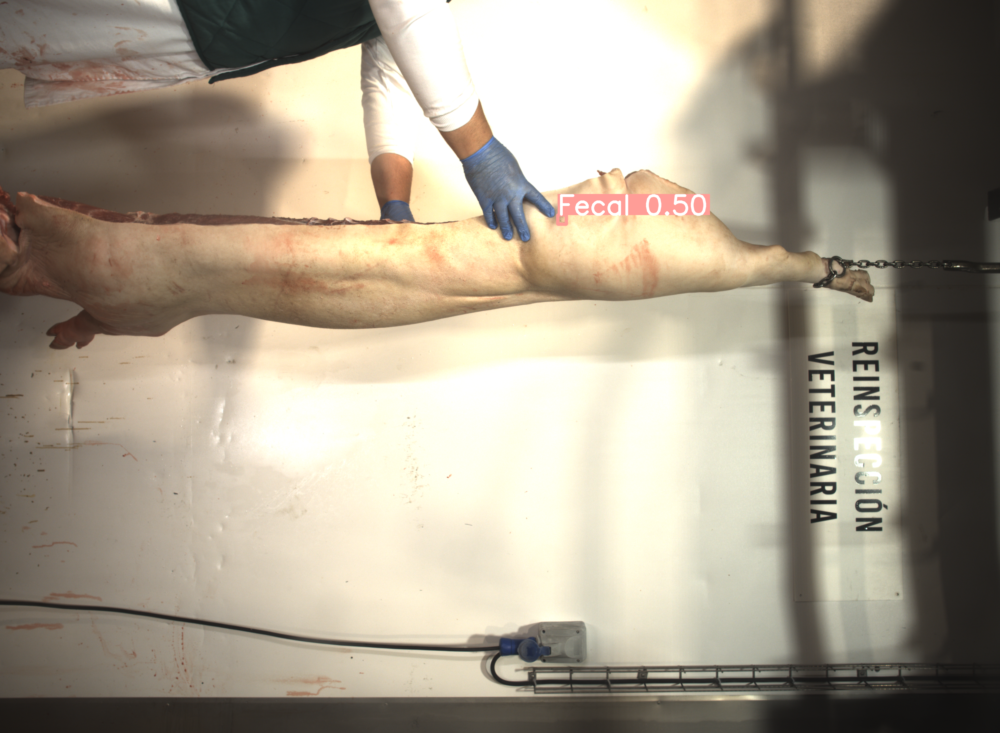

In [12]:
results[0].show()

In [24]:
# Evaluation on the test set.
!yolo val \
split='val' \
model='/home/enzo.viacava/runs/detect/yolov8s-p2_640_2_class_1200/weights/best_openvino_model' \
data='matadero.yaml' \
plots=True


Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.2+cu121 CPU (AMD EPYC 7742 64-Core Processor)
Loading /home/enzo.viacava/runs/detect/yolov8s-p2_640_2_class_1200/weights/best_openvino_model for OpenVINO inference...
Using OpenVINO LATENCY mode for batch=1 inference...
Forcing batch=1 square inference (1,3,640,640) for non-PyTorch models
val: Scanning /home/enzo.viacava/media/Datasets/Matadero/images_yolo/val/labels.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all         12         15      0.785        0.8      0.806      0.371
                Biliar         12          5      0.937          1      0.995      0.442
                 Fecal         12         10      0.634        0.6      0.618        0.3
Speed: 2.6ms preprocess, 53.7ms inference, 0.0ms loss, 72.9ms postprocess per image
Results saved to runs/detect/val9
💡 Learn more at https://docs.ultralytics.com/modes/val
